# Assignment 2 - Lorgna Lorenzo - 829776

# Richiesta
Answer the following questions:
1) What is the difference in the average the global mean temperature anomaly for the last 30 years of the record, compared to that of the first three decades of the twentieth century ?
2) Is this difference statistically significant ?
You can use and extend the example from class.

In [53]:
# Libraries

import os

import numpy as np
import pandas as pd
import geopandas as gpd

import datetime as dtm
from datetime import datetime

import matplotlib.pyplot as plt
import cartopy.crs as ccrs

from scipy import stats

# Lettura dataset

In [54]:
#-------------------------------------------------
#-- get info on database and files organization --
#-------------------------------------------------

# per capire come è costituito il dataset
flist = [os.path.join(path, name) for path, subdirs, files in os.walk("./CRUTEM.4.6.0.0.station_files/") for name in files]  # contiene i dati grezzi derivanti da una serie di stazioni meteorologiche
for i in range(0,5):
  print (flist[i])

# exclude first 2 items, not relevant
flist=flist[2:]

# Alternativly
#import glob
#flist = glob.glob("./CRUTEM.4.6.0.0.station_files/"+'/*/*')

print ('\n',flist[0:5])
nst=len(flist)
print ("\n > Number of stations = ",nst)  # si hanno più di 10k stazioni

./CRUTEM.4.6.0.0.station_files/Index
./CRUTEM.4.6.0.0.station_files/01\010010
./CRUTEM.4.6.0.0.station_files/01\010030
./CRUTEM.4.6.0.0.station_files/01\010050
./CRUTEM.4.6.0.0.station_files/01\010070

 ['./CRUTEM.4.6.0.0.station_files/01\\010030', './CRUTEM.4.6.0.0.station_files/01\\010050', './CRUTEM.4.6.0.0.station_files/01\\010070', './CRUTEM.4.6.0.0.station_files/01\\010080', './CRUTEM.4.6.0.0.station_files/01\\010100']

 > Number of stations =  10295


In [55]:
# I will start by simply acquiring data & metadata in separate dataframes

# Metadati

In [56]:
# per motivi computazionali metadata0 è stato già processato e salvato in formato pickle. Si procede dunque alla lettura di tale file.


# The first challenge is to correctly read in the data from an individual ASCII files.

# Define df to store ##metadata##.
# Station IDs will be used as unique identifiers for both dataframes.



# metadata0 = pd.DataFrame(columns=['ID','stname','country','elev','lat','lon'])
# metadata0
metadata0 = pd.read_pickle("metadata0.pickle")
metadata0

,ID,stname,country,elev,lat,lon
0,010050,ISFJORD RADIO,NORWAY,9.0,78.0,-14.2
1,010070,NY-ALESUND,NORWAY,8.0,78.9,-11.9
2,010080,Svalbard Lufthavn,NORWAY,28.0,78.3,-15.5
3,010100,ANDENES,NORWAY,-999.0,69.3,-16.2
4,010101,BORKENES,NORWAY,36.0,68.8,-16.2
...,...,...,...,...,...,...
7451,998504,MLINGANO NGOMENI,TANZANIA,183.0,-5.2,-38.9
7452,998513,ILONGA MET OFFICE,TANZANIA,503.0,-6.8,-37.0
7453,999202,BALCARCE-INTA(BUENOS,ARGENTINA,130.0,-37.8,58.3
7454,999221,T2004.PASOI,ARGENTINA,498.0,-38.5,69.4


# Dati

In [57]:
# per motivi computazionali data0 è stato già processato e salvato in formato pickle. Si procede dunque alla lettura di tale file.


# si costruisce un asse temporale comune (granularità mensile)

# First, I will define a common time axis, along which all time series will be aligned. This will be the index of gdf.

taxis = pd.date_range('1850-01', '2019-01', freq='M')
nmonths=len(taxis)
nyears=nmonths/12

# Define df to store data (temperature time series) and location.

# data0 = pd.DataFrame({'time': taxis})
# data0 = data0.set_index(['time'])
# data0
data0 = pd.read_pickle("data0.pickle")
data0

,010050,010070,010080,010100,010101,010150,010170,010230,010250,010251,...,990160,990180,990900,991260,993801,998504,998513,999202,999221,999234
time,,,,,,,,,,,,,,,,,,,,,
1850-01-31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1850-02-28,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1850-03-31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1850-04-30,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1850-05-31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-08-31,NaN,5.6,6.8,NaN,NaN,NaN,NaN,NaN,11.7,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2018-09-30,NaN,0.5,1.7,NaN,NaN,NaN,NaN,NaN,8.3,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2018-10-31,NaN,-1.6,-1.4,NaN,NaN,NaN,NaN,NaN,3.7,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


# Periodo di riferimento

In [58]:
# Define reference period

# sono richieste le anomalie di temperatura rispetto ad un periodo di riferimento
yref0 = 1961
yref1 = 1990

In [59]:
# il codice di seguito non viene eseguito perchè dati e metadati come detto in precedenza sono già stati salvati in formato pickle

# # Dataset acquisition
#
nst_tmp = nst   # numero delle stazioni
# # nst_tmp = 10   #nst #200
#
# #- set counters for diagnostics
# nodatacount=0
# tooshortcount=0
# outsidecount=0
#
# from tqdm import tqdm
#
# # iterazione su tutti i file
# for si in tqdm(range(0,nst_tmp)):
#
#   #- open file
#
#   filein=flist[si]  # elenco di tutti i percorsi dei file, di tutte le stazioni
#
#   #- Scan text file to find starting line of data matrix &
#   #- check for the actual presence of data
#
#   # apertura di ogni file relativo ad una stazione
#   try:
#       with open(filein) as f: data = f.readlines()
#       skipi = data.index("Obs:\n")+1  # divide la prima parte che contiene i metadati e la seconda parte che contiene i dati
#       if (len(data)-skipi < 2):
#         nodatacount+=1  # se non si hanno dati si va ad incrementare il contatore nodatacount
#         continue
#
#       #- Find out how many years are in the time series for this station &
#       #-   apply some filters on the time series lenght and/or timing as a condition to include the station in the dataset
#       #- I could use the metadata (Start year, End year) or
#       #-   get this piece of info from the actual data >>> I chose the second option
#
#       # applico dunque già dei filtri
#
#       #- I read the first column of the data table, which constains the list of years
#       yr = np.genfromtxt(filein, skip_header=skipi, delimiter=None, usecols=0, dtype='i4')
#       nyr = len(yr)
#
#       # this filters out data series that are too short (e.g. less than 30 years)
#       if (nyr < 30):
#         tooshortcount+=1
#         continue
#
#       # do not retain series not covering at least in part the reference period
#       #if (yr[0]>yref1 or yr[-1]<yref0):
#       #  outsidecount+=1
#       #  continue
#
#       # OR
#
#       # retain only the stations for which the calculation of the average annual cycle for the reference period
#       # yields non-NAN values for each month, i.e. the normals have no missing value
#
#       norm_line = [line for line in data if "Normals=" in line]
#       norm = str(norm_line).split("=",1)[1]
#       norm  = norm[:-4].strip()
#       if (norm.find("-99.0") > -1):   #str.find returns the position of the given substring, -1 if not found, controllo se ci sono missing values
#         outsidecount+=1
#         continue
#
#       #- If the station is retained, then gather data & metadata
#           # se la stazione non è stata scartata si procedere ad estrarre i metadati
#
#       # FROM THE TEMPLATE ...
#       # Name= LONDON/GATWICK
#       # Country= UK
#       # Lat=   51.2
#       # Long=    0.2
#       # Height= 59
#
#       # Get local values for * METADATA * of interest
#
#       # considerando tutti gli elementi dei metadati
#       stname_line = [line for line in data if "Name=" in line]
#       stname = str(stname_line).split("=",1)[1]
#       stname  = stname[:-4].strip()
#
#       country_line = [line for line in data if "Country=" in line]
#       country = str(country_line).split("=",1)[1]
#       country  = country[:-4].strip()  # this removes leading & trailing strings, incl. "new line" [\n] at the end
#
#       elev_line = [line for line in data if "Height=" in line]
#       elev = str(elev_line).split("=",1)[1]
#       elev = float(elev[:-4].strip())
#
#       lat_line = [line for line in data if "Lat=" in line]
#       lat = str(lat_line).split("=",1)[1]
#       lat = float(lat[:-4].strip())
#
#       lon_line = [line for line in data if "Long=" in line]
#       lon = str(lon_line).split("=",1)[1]
#       lon = float(lon[:-4].strip())
#
#       # Append local values to metadata df
#       # creo questa struttura
#       metadata0 = metadata0.append({
#          "ID": filein[-6:],
#          "stname": stname,
#          "country": country,
#          "elev": elev,
#          "lat":  lat,
#          "lon":  lon,
#          }, ignore_index=True)
#
#         # ora si passa ad acquisire i dati veri e propri
#
#       #- Finally, read and arrange * DATA * (temperature time series)
#
#       # FROM THE TEMPLATE ...
#       # ...
#       # Obs:
#       # 1961   3.9   7.1   7.5  10.3  11.0  14.7  15.9  16.1  15.7  10.9   6.4   2.7   501   501   501   501   501   501   501   501   501   501   501   501
#       # 1962   4.1   4.5   2.5   7.6   9.8  13.0  15.1  14.7  12.6  10.5   5.9   1.7   501   501   501   501   501   501   501   501   501   501   501   501
#
#       # We need to go from 2D to 1D oragnization of temperature data &
#       #  associate each temperature to a datetime index
#       # This way we can coherently build a 2D df (time, station),
#       #  on which we could later drop stations or slice/gropuby by time
#       # >>> I will build a local df, then append it to the general df
#
#       #- build local time axis
#       # yr: the first column of the data table, which constains the list of years (defined above)
#
#       ti0 = datetime.strptime(str(yr[0]), "%Y")
#       ti1 = datetime.strptime(str(yr[nyr-1]+1), "%Y")
#       stime = pd.date_range(ti0, ti1, freq='M')
#       if ((yr[nyr-1]-yr[0]+1) != len(yr)):  # check if data of any year are missing within the first and last year
#         print('WARNING: station {} has missing years !'.format(metadata0.ID[si]))
#
#       #- read in the 2D table (left side with temperature data) as a numpy array, which I can later reshape into 1D
#
#       loc_data_2d = np.genfromtxt(filein, skip_header=skipi, filling_values='-99.0', delimiter=None, dtype='float')[:,1:13]  #[rows,cols]
#       loc_data_1d = loc_data_2d.flatten()
#
#       #- check that the order of element rearrangement is correct
#       #print(np.shape(loc_data_2d),nyr)
#       #print('@@',loc_data_2d[:2,:])
#       #print(loc_data_1d[:24],'\n')
#
#       #- build local station dataframe, using the station ID as column name
#
#       xdf = pd.DataFrame({'time': stime, filein[-6:]: np.asarray(loc_data_1d)})
#       xdf = xdf.set_index('time')
#
#       #- merge into global dataframe, using the station ID as column name
#
#       data0 = pd.merge(data0, xdf, on='time', how='left')
#   except:
#       print(f)
#       continue


# è stato necessario inserire un try & except dal momento in cui il file 961690 non presentava la sezione dei dati, quindi il codice "Obs:\n" genereva un errore

In [60]:
# salvataggio di data0 e metadata0 in formato pickle
# data0.to_pickle('data0.pickle')
# metadata0.to_pickle('metadata0.pickle')

In [61]:
# # Print some info
#
# print(nodatacount,' stations with no data (not acquired)')
# print(tooshortcount,' stations with too little data (not acquired)')
# print(outsidecount,' stations with not enough data for the ref. period (not acquired)')
# print("{} [{}] valid stations acquired".format(nst_tmp-nodatacount-tooshortcount-outsidecount,len(metadata0.ID)))

# Pre-processing e esplorazione

In [62]:
# Now think of additional pre-processing operations / checks that might be desirable

# sono stati acquisiti i dati ma è necessario ancora del pre processing

In [63]:
# Convert all missing values (-99.0) into NAN
data0[data0 == -99.0] = np.nan

In [64]:
# Take station IDs as index for metadata0
metadata0 = metadata0.set_index(['ID'])

In [65]:
# Fix longitudes, dato che le longitudini sono state invertite
metadata0.lon = -metadata0.lon

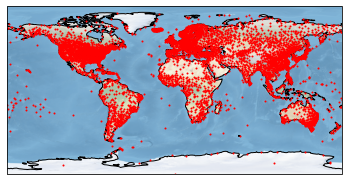

In [66]:
# Plot stations in our dataset, utilizzando latitudine e longitudine contenuti del df dei metadati

ax = plt.axes(projection=ccrs.PlateCarree())
ax.coastlines()
ax.stock_img()
ax.scatter([metadata0.lon],[metadata0.lat],color='r',marker='o',s=1.0)
plt.show()

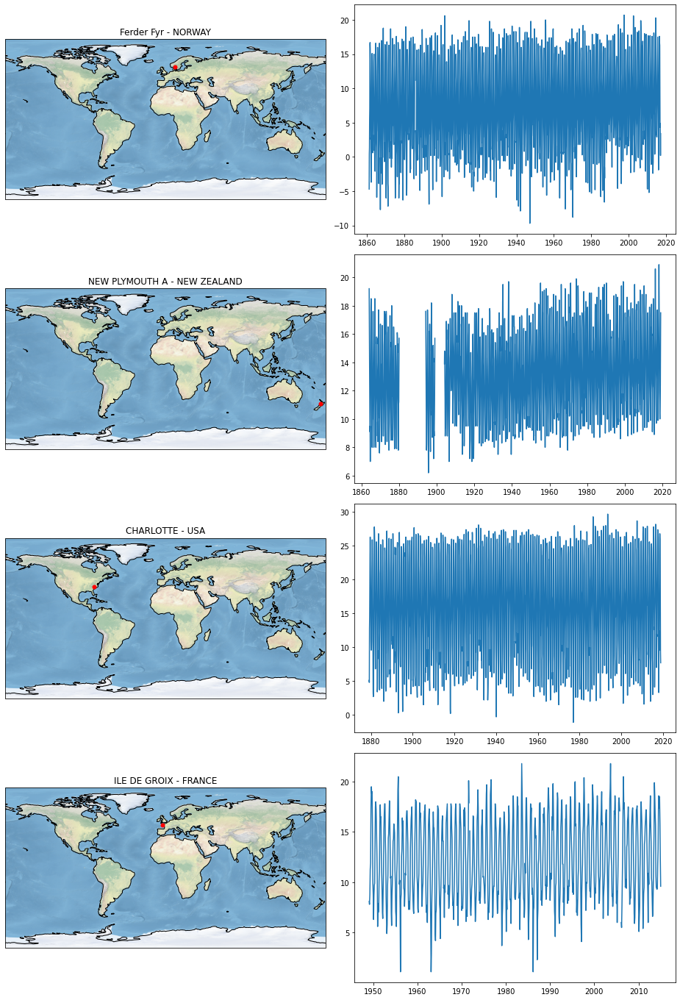

In [67]:
#-- Plot time series from a few randomly chosen stations --

# oltre alle stazioni come informazioni si hanno anche le serie temporali che sono associate alle varie stazioni

#- Set multipanel plot
fig = plt.figure(figsize=(13,19))

no = 4  # number of randomn stations to pick, c'era 6

subplots = (no,2)
n_panels = subplots[0] * subplots[1]

proj = ccrs.PlateCarree()

#- Select sites
rssite = np.random.randint(len(data0.columns), size=no)
ssite = metadata0.index[rssite]

for fi, f in enumerate(ssite):

    #- locate on map
    ax = fig.add_subplot(subplots[0], subplots[1], (fi*2)+1, projection=proj)
    ax.set_title(' - '.join([metadata0.stname[ssite[fi]],metadata0.country[ssite[fi]]]))
    ax.stock_img()
    ax.coastlines()
    plt.plot(metadata0.lon[ssite[fi]], metadata0.lat[ssite[fi]],
         color='red', marker='o', markersize=5,
         transform=ccrs.Geodetic())

    #- time series
    tser = fig.add_subplot(subplots[0], subplots[1], (fi+1)*2)
    #data0[ssite[fi]].plot()
    plt.plot(data0[ssite[fi]])

fig.tight_layout()
plt.show()


# si osservano posizioni differenti, serie temporali con coperture differenti

In [68]:
# PASSO 1


# (1) Deal with the time series, in particular what to do about missing data

# We could decide
#   to retain only stations with complete records,
#   or to retain for every station only the years with at least 6 months of data, etc.
# We could also decide e.g.
#   to assign the missing data based on the nearest (in time) value for the same month at the same station
#   or to assign the missing data based on the nearest (in space) value for the same month from a different station

# In this example I will just go on without further pre-processing operations

# Calcolo temperature anomaly

In [69]:
# PASSO 2

# (2) Transform all TEMPERATURE time series to TEMPERATURE ANOMALY time series, with respect to a reference period
# vengono calcolate delle climate normals (AVERAGE ...) rispetto al periodo di riferimento su base mensile. Effettuando la differenza (DATI - AVERAGE) è possibile rimuovere il ciclo annuale dai dati e centrare i dati stessi.

# ANOMALY(y,m) = DATA(y,m) - AVERAGE[ref. period](m) , for each month (m=1..12), for each year (y=1850..2019)

# AVERAGE[ref. period](m) is in fact the "Normals", that we could have stored while acquiring the data & metadata, or
#  alternatively we could recalculate here. I will show how to proceed for the second option.

In [70]:
# si calcolano le CLIMATE NORMALS

# First, let's identify the position along the time index that corresponds to the begining/end of the reference period

# sono i due indici, inziale e finale, del periodo di riferimento
x1=data0.index.get_loc('1961-01-31')
x2=data0.index.get_loc('1990-12-31')

# Then calculate the "Normals"

data_normals = data0[x1:x2].groupby(data0[x1:x2].index.month).mean()  # vengono cosi calcolate le NORMALI CLIMATICHE, ovvero le medie su base mensile, si hanno le climate normals stazione per stazione per i 12 mesi dell'anno. Per ogni stazione si ha cosi il ciclo annuale medio rispetto al periodo di riferimento
# data_normals





# ora si calcolano le ANOMALIE, quindi si sottrae mese per mese alla serie temporale in questione il valore del corrispettivo mese delle climate normals


# Finally, let's subtract normals from the the original time series, to get
# the time series of the temperature anomalies for each station
# (Note that this operation would be efficiently done with 2D data organization, such as in the original text files)

# Make a copy of data0 (data_anom) to store the anomalies

data_anom = data0.copy()  # è necessario .copy() altrimenti data0 viene sovrascritto

# Then loop through all the years (January) in the time axis, and substract the Normals from each chunk of 12 months

y0=0
for yi in range(0,int(nyears)):
  data_anom.iloc[y0:y0+12,:] = data0.iloc[y0:y0+12,:]-np.array(data_normals.iloc[:,:])
  y0+=12

# data_anom

In [71]:
data_anom

,010050,010070,010080,010100,010101,010150,010170,010230,010250,010251,...,990160,990180,990900,991260,993801,998504,998513,999202,999221,999234
time,,,,,,,,,,,,,,,,,,,,,
1850-01-31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1850-02-28,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1850-03-31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1850-04-30,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1850-05-31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-08-31,NaN,1.540909,2.130000,NaN,NaN,NaN,NaN,NaN,0.913793,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2018-09-30,NaN,0.318182,1.440000,NaN,NaN,NaN,NaN,NaN,1.489655,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2018-10-31,NaN,3.709091,4.046667,NaN,NaN,NaN,NaN,NaN,0.760000,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [72]:
data0

,010050,010070,010080,010100,010101,010150,010170,010230,010250,010251,...,990160,990180,990900,991260,993801,998504,998513,999202,999221,999234
time,,,,,,,,,,,,,,,,,,,,,
1850-01-31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1850-02-28,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1850-03-31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1850-04-30,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1850-05-31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-08-31,NaN,5.6,6.8,NaN,NaN,NaN,NaN,NaN,11.7,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2018-09-30,NaN,0.5,1.7,NaN,NaN,NaN,NaN,NaN,8.3,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2018-10-31,NaN,-1.6,-1.4,NaN,NaN,NaN,NaN,NaN,3.7,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [73]:
data_normals

,010050,010070,010080,010100,010101,010150,010170,010230,010250,010251,...,990160,990180,990900,991260,993801,998504,998513,999202,999221,999234
time,,,,,,,,,,,,,,,,,,,,,
1,-12.193750,-13.447619,-15.340000,-2.083333,-2.762963,-2.140000,-4.307143,-10.343333,-4.158621,-6.607143,...,5.111111,3.311538,3.216667,3.470000,25.520,27.186207,26.096667,20.145455,22.539286,24.610000
2,-12.725000,-14.138095,-16.250000,-2.156667,-2.440741,-1.986667,-4.142857,-8.883333,-3.917241,-5.703571,...,4.815789,3.340000,3.373684,3.633333,28.380,27.613793,26.123333,19.709091,21.514286,23.310345
3,-12.381250,-13.695238,-15.710000,-1.426667,-0.777778,-0.963333,-2.462963,-4.703333,-2.562069,-3.475000,...,4.594444,3.269231,3.179167,5.626667,31.035,27.496552,25.956667,17.727273,18.289286,19.855172
4,-9.887500,-10.976190,-12.293333,0.990000,1.844444,1.586667,0.957143,0.263333,0.617241,0.950000,...,5.105556,4.176923,4.260000,7.816667,33.240,26.351724,25.080000,14.268182,14.007143,15.640000
5,-3.687500,-3.376190,-4.326667,5.156667,6.333333,5.341379,5.517857,5.923333,4.879310,6.142308,...,6.642105,6.250000,6.137037,11.176667,33.725,24.989286,23.710000,10.908333,10.307407,11.770000
6,1.531250,1.795238,1.986667,8.556667,10.225926,8.693103,9.721429,10.780000,9.100000,10.488889,...,8.516667,8.291667,8.303704,14.183333,30.890,23.924138,21.856667,8.069565,7.396429,8.324138
7,4.787500,5.128571,5.766667,11.040000,12.670370,11.164286,11.909091,13.030000,11.617241,13.050000,...,10.915789,10.004167,9.936667,16.193333,28.245,23.289286,21.660000,7.956000,7.110714,8.200000
8,4.120000,4.059091,4.670000,11.053333,12.048148,11.103571,11.554545,11.983333,10.786207,11.975000,...,12.689474,10.700000,10.610714,16.033333,27.005,23.270000,22.613333,8.868000,8.944828,10.268966
9,0.800000,0.181818,0.260000,7.800000,8.211111,7.950000,7.688000,6.850000,6.810345,7.362963,...,12.521053,9.124000,9.016667,13.783333,27.350,23.786667,24.003333,10.562500,11.220690,13.243333


In [74]:
# osservando i dati sopra riportati si può verificare che le anomalie sono state correttamente calcolate.

# esempio: si considera il valore di data0 (la serie in questione) 1976-05-31 pari a -1.9, si considera il valore di maggio nelle climate normals (il valore che in media ci si aspetterebbe) pari a -3.687500. La anomalia, ovvero di quanto si discosta la serie in questione dalla normale, sarà pari a -1.9 - (- 3.687500) che risulta come indicato pari a 1.787500.

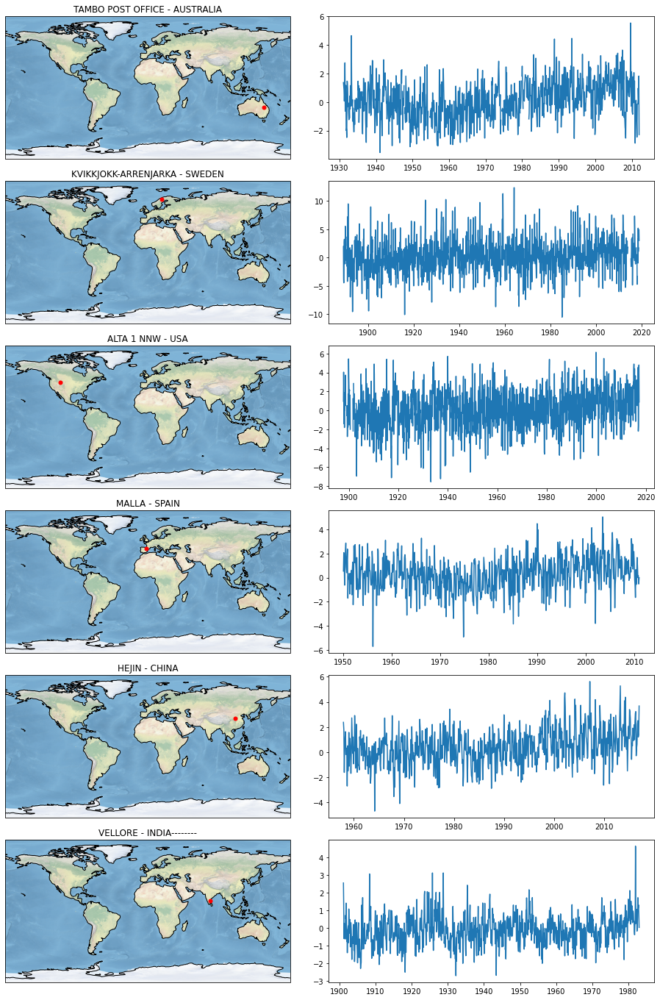

In [75]:
#-- Plot time series from a few randomly chosen stations --
# si plotta come prima ma in questo caso le anomalie calcolate, effettivamente i dati sono centrati intorno allo zero in un periodo di riferimento. Guardando i grafici sarebbe necessario gestire i missing values. Queste serie non mostrano neanche chiari segni di cicli annuali (vedi infatti formula, è stato sottratto anche il ciclo annuale).

#- Set multipanel plot
fig = plt.figure(figsize=(13,19))

no = 6   # number of randomn stations to pick

subplots = (no,2)
n_panels = subplots[0] * subplots[1]

proj = ccrs.PlateCarree()

#- Select sites
rssite = np.random.randint(len(data0.columns), size=no)
ssite = metadata0.index[rssite]

for fi, f in enumerate(ssite):

    #- locate on map
    ax = fig.add_subplot(subplots[0], subplots[1], (fi*2)+1, projection=proj)
    ax.set_title(' - '.join([metadata0.stname[ssite[fi]],metadata0.country[ssite[fi]]]))
    ax.stock_img()
    ax.coastlines()
    plt.plot(metadata0.lon[ssite[fi]], metadata0.lat[ssite[fi]],
         color='red', marker='o', markersize=5,
         transform=ccrs.Geodetic())

    #- time series
    tser = fig.add_subplot(subplots[0], subplots[1], (fi+1)*2)
    #data0[ssite[fi]].plot()
    plt.plot(data_anom[ssite[fi]])

fig.tight_layout()
plt.show()

# Aggregazione spaziale e temporale

In [76]:
# PASSO 3


# il primo step di aggregazione spaziale è possibile effettuarlo a base mensile.
# poi si farà lo step di aggregazione temporale
# e poi step finale di aggregazione

# (3) First step of spatial aggregation: gridding at monthly time step - si crea una griglia regolare, si omogeneizza la distribuzione spaziale del dataset in questione facendo la media delle anomalie delle stazioni presenti nelle celle insieme

# All data are aggregated (averaged) in a regular lat/lon grid covering the Earth surface (e.g. 10x10 or 5x5 deg.)
# In this way, we are "homogenizing" the spatial distribution of our dataset

# Here there are a few strategies that can be followed.

# One way would be to build a grid (e.g. a couple of 1D lists/arrays or one 2D array) containing the
#  lats/lons margins of grid cells. Then slicing based on lats and lons ranges can be used to calculate the average
#  time series from the grid cell.

# A similar approach (non è l'approccio seguito) could be devised using geopandas, attributing lat/lon station coordinates to point geometries,
#  defining the regular grid as a series of polygons. Then it would be possible to use geopandas geometry functions
#  to operate a "geometry slicing", i.e. points contained within a given polygon.
#  http://blog.yhat.com/posts/interactive-geospatial-analysis.html

In [77]:
# (4) Aggregate the gridded data from monthly to annual time step

# By doing this operation after (3), we are in fact still exploiting data from stations with some missing data


# PASSO 3 e 4

In [78]:
# In this phase we can either
# - consider all data, irrespective of the fact that a given year has NAN for ceratin values
# - or set to NAN all incomplete years

In [79]:
# In this phase we can either
# - consider all data, irrespective of the fact that a given year has NAN for ceratin values
# - or set to NAN all incomplete years

In [80]:
# I will proceed in this example, using the first strategy, for both (3) and (4)

In [81]:
# create grid

resol = 20 #5 # degrees (E and N)
nlon = int(360/resol)
nlat = int(180/resol)

# define grid cell margins
grlons = np.empty([nlon+1],dtype='float')
grlats = np.empty([nlat+1],dtype='float')

grlons[0] = -180.
grlats[0] = -90.
for i in range(1,nlon+1):
    grlons[i]=grlons[i-1]+resol
for i in range(1,nlat+1):
    grlats[i]=grlats[i-1]+resol

In [82]:
# Create data structure to host the gridded dataset:
# what will it be ?  -> I chose 3D numpy array

# queste strutture riempite temporaneamente con dei nan
data_mo = np.empty([nmonths,nlat,nlon],dtype=float)
data_mo[:,:,:] = np.nan

data_yr = np.empty([int(nyears),nlat,nlon],dtype=float)
data_yr[:,:,:] = np.nan

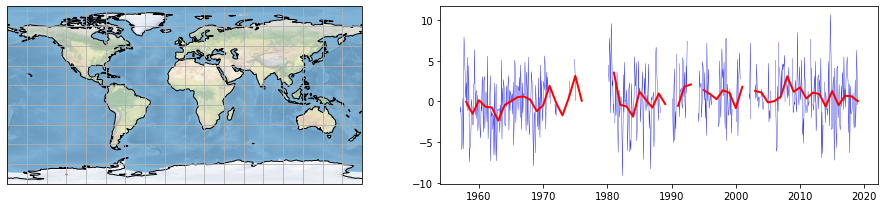

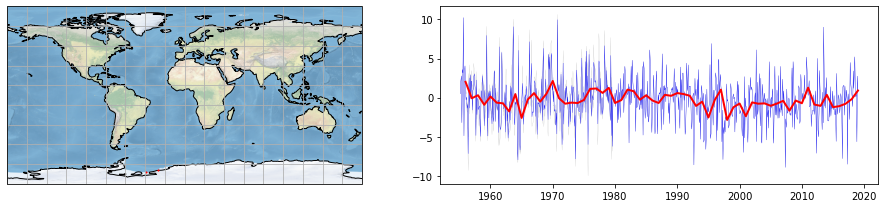

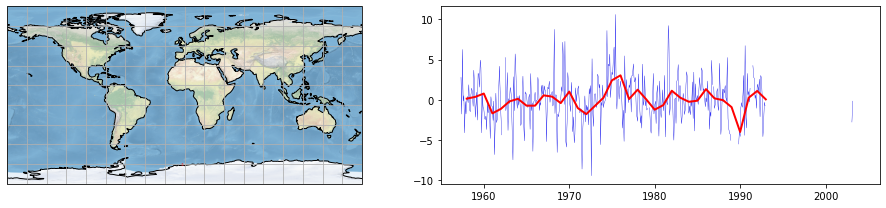

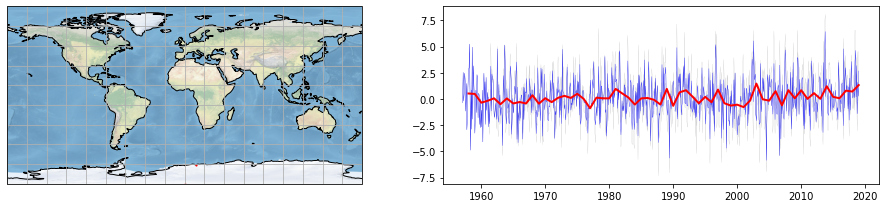

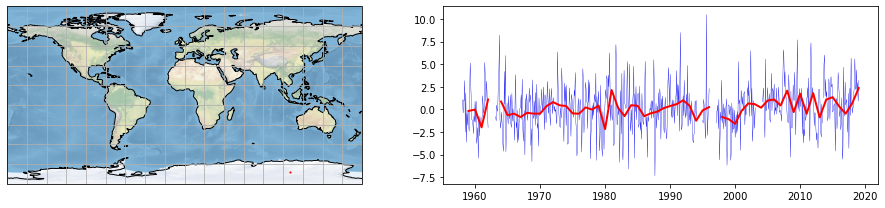

...

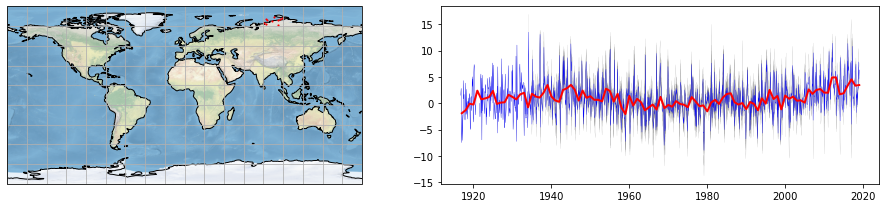

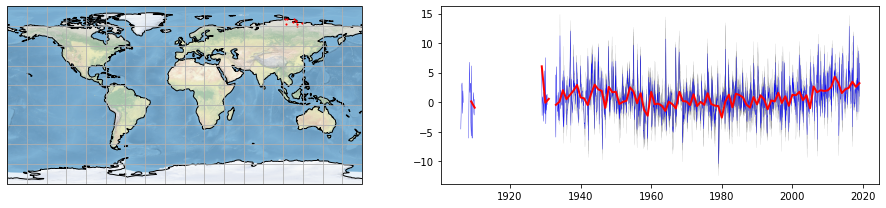

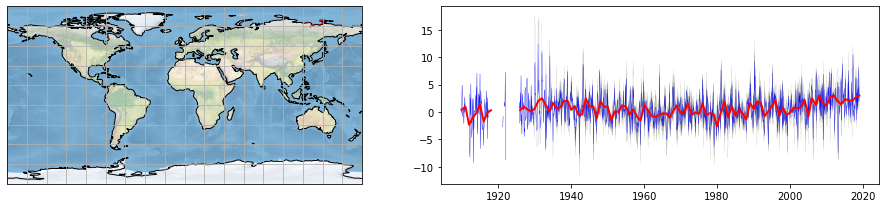

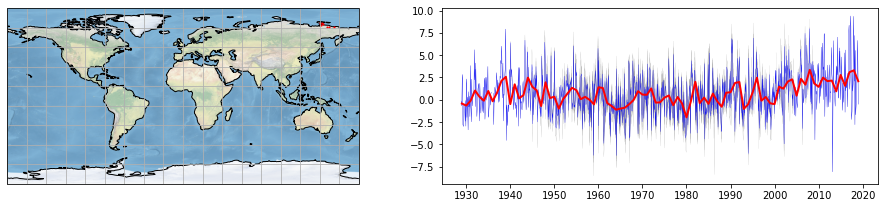

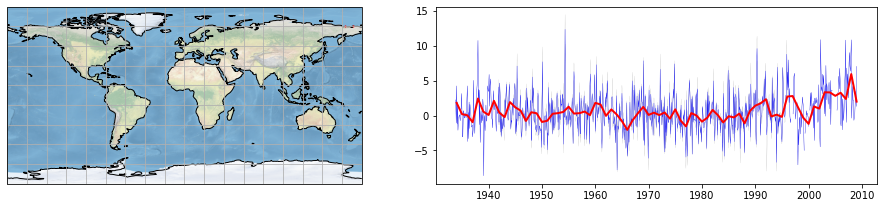

In [83]:
# Iterate over grid cells and
# - get the average time series of all stations in grid cell at monthy resolution
# - integrate to annual resolutin

# ciclo sulle latitudini e longitudini
# si procede ad analizzare ogni cella della griglia che è stata creata singolarmente
for j in range(0,nlat):
  for i in range(0,nlon):

    # ad esempio considerando la prima cella, 0:0

    dummy = metadata0[metadata0.lon >= grlons[i]]  # si vanno a selezionare tutte le stazioni (sono gli id in metadata0) che rientrano nella cella 0 ad esempio, <, >= ecc sono i vincoli per far si che la stazione sia dentro quella cella
    dummy = dummy[dummy.lon < grlons[i+1]]
    dummy = dummy[dummy.lat >= grlats[j]]
    dummy = dummy[dummy.lat < grlats[j+1]]

    #print('*',grlons[i],grlons[i+1],grlats[j],grlats[j+1])
    #print(dummy.index)

    if len(dummy.index) > 0:  # se c'è almeno una stazione in quella cella

      # calculation - si va a calcolare la media di tutte le stazioni che sono nell'elenco della cella

      data_mo[:,j,i] = np.array(data_anom[dummy.index].mean(axis=1)).flatten()  # media su base mensile, colore blu

      data_yr[:,j,i] = np.array(data_anom[dummy.index].mean(axis=1).resample("Y").mean()).flatten()  #  media su base annuale, colore rosso

      # in grigio sono le anomalie delle stazioni prese separatamente, non calcolando dunque la media
      # display to check things
      fig = plt.figure(figsize=(13,3))
      subplots = (1,2)
      n_panels = subplots[0] * subplots[1]

      #- locate on map
      ax = fig.add_subplot(subplots[0], subplots[1], 1, projection=ccrs.PlateCarree())
      ax.stock_img()
      ax.coastlines()
      ax.gridlines(xlocs=range(-180,181,resol), ylocs=range(-90,91,resol))
      ax.scatter([dummy.lon],[dummy.lat],color='r',marker='o',s=1.2)

      #- time series
      tser = fig.add_subplot(subplots[0], subplots[1], 2)
      plt.plot(taxis,np.array(data_anom[dummy.index]),color='grey',linewidth=0.1)
      plt.plot(taxis,data_mo[:,j,i],color='blue',linewidth=0.3)
      plt.plot(pd.date_range('1850-01', '2019-01', freq='Y'),data_yr[:,j,i],color='red',linewidth=2)

      fig.tight_layout()
      plt.show()
      # alcuni outliers potrebbero essere eliminati

# Aggregazione spaziale globale

In [84]:
# PASSO 5

# (5) Second step of spatial aggregation: derive the global time series from the gridded dataset
# bisogna fare un'aggregazione di tutte le celle

In [85]:
# Here we have the options of a simple arithmetic average, or a weighted average
# The weights could be on several levels, e.g.
# - a measure of the density of observations or their coherence
# - the unequal areas covered by each grid cell
# - the unequal proportions of land vs ocean in different grid cells
# - ...

In [86]:
# In this case, I will simply use the arithmetic average

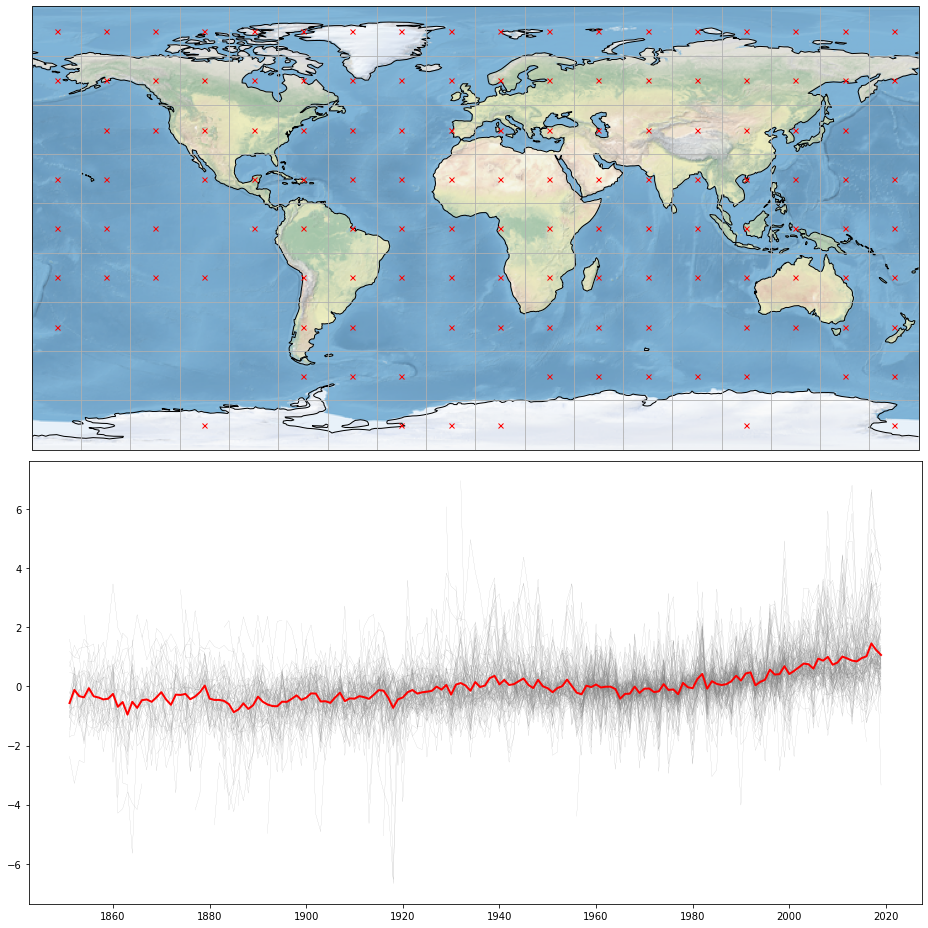

In [87]:
# Prepare to display to check things

fig = plt.figure(figsize=(13,13))
subplots = (2,1)

ax = fig.add_subplot(subplots[0], subplots[1], 1, projection=ccrs.PlateCarree())
ax.stock_img()
ax.coastlines()
ax.gridlines(xlocs=range(-180,181,resol), ylocs=range(-90,91,resol))

tser = fig.add_subplot(subplots[0], subplots[1], 2)

# Initialize data structure to host global average temperature anomaly time series

data_glob = np.empty([int(nyears)],dtype=float)
data_glob[:] = np.nan

# loop over all grid cells

for j in range(0,nlat):
  for i in range(0,nlon):

    # Check if current grid cell has an associated time series

    if not(np.isnan(data_yr[:,j,i]).all()):

      #  place a marker on the map, and plot individual grid cell time series

      ax.plot( grlons[i:i+2].sum()/2, grlats[j:j+2].sum()/2,
         color='red', marker='x', markersize=5,transform=ccrs.PlateCarree())
      plt.plot(pd.date_range('1850-01', '2019-01', freq='Y'),data_yr[:,j,i],color='gray',linewidth=0.1)

# calculate the global average at each time step

for t in range(0,int(nyears)):

    local = data_yr[t,:,:]
    valid = np.isnan(data_yr[t,:,:])
    data_glob[t] = np.nanmean(local[~valid])

# plot the global average curve

plt.plot(pd.date_range('1850-01', '2019-01', freq='Y'),data_glob[:],color='red',linewidth=2)

fig.tight_layout()
plt.show()

# la linea rossa è la global mean temperature anomalies (gmta)

In [88]:
# print to file the time series of global mean temperature anomalies (gmta)

# si stampa su file quest'ultima serie temporale (linea rossa)

gmta = pd.DataFrame({'time': pd.date_range('1850-01', '2019-01', freq='Y')})
gmta['gmta'] = data_glob[:]
gmta = gmta.set_index(['time'])

gmta.to_csv('_'.join(['gmta',str(int(nst_tmp)),'stations']))

In [89]:
# Note that estimation of uncertainties in the different passages could be calculated, and propagated
# Also, it would be possible to perform several realizations of selecting sub-gropus of stations (bootstrap)
# Several "cleaning" / pre-processing operations could be considered, e.g. removal of outliers (e.g. > n St.dev.)

# Selezione prime 3 decadi e ultime 3 decadi dei record a disposizione

In [90]:
# selezione prime tre decadi: 1900 1930
# selezione ultimi 30 anni: dal 1988 al 2018


# What is the difference in the average the global mean temperature anomaly for the last 30 years of the record, compared to that of the first three decades of the twentieth century ?
# Is this difference statistically significant ? You can use and extend the example from class.
# Quali sono le differenze nelle anomalie di temperatrura media globali negli 30 anni del record rispetto a quelle delle prime 3 decadi del secolo?

In [91]:
gmta

,gmta
time,
1850-12-31,-0.564252
1851-12-31,-0.117734
1852-12-31,-0.329241
1853-12-31,-0.369994
1854-12-31,-0.060377
...,...
2014-12-31,0.958102
2015-12-31,1.018529
2016-12-31,1.453253


In [92]:
gmta_first_30_yrs = gmta[gmta.index > '1900-12-31'][:30]
# gmta_first_30_yrs

gmta_last_30_yrs = gmta[-30:]
# gmta_last_30_yrs

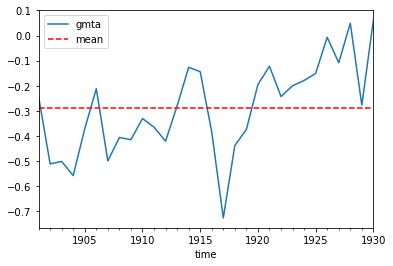

In [93]:
# gmta_first_30_yrs.plot()

fig, ax = plt.subplots()
gmta_first_30_yrs['gmta'].plot()
plt.axhline(y=gmta_first_30_yrs['gmta'].mean(), color='r', linestyle='--', label='mean')
plt.legend()
plt.show()
# plt.title('')
# plt.xlabel('')

In [94]:
gmta_first_30_yrs.mean()

gmta   -0.288983
dtype: float64

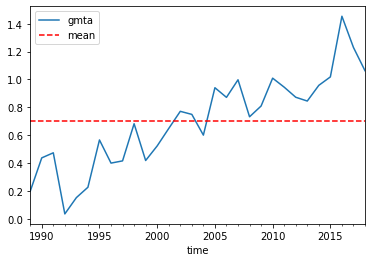

In [95]:
# gmta_last_30_yrs.plot()

fig, ax = plt.subplots()
gmta_last_30_yrs['gmta'].plot()
plt.axhline(y=gmta_last_30_yrs['gmta'].mean(), color='r', linestyle='--', label='mean')
plt.legend()
plt.show()
# plt.title('')
# plt.xlabel('')

In [96]:
gmta_last_30_yrs.mean()

gmta    0.702015
dtype: float64

# Calcolo differenza

In [97]:
diff = gmta_last_30_yrs['gmta'].mean() - gmta_first_30_yrs['gmta'].mean()
diff

0.9909973208433773

# T-test per verificare significatività della differenza riscontrata

In [98]:
stats.ttest_ind(gmta_last_30_yrs['gmta'], gmta_first_30_yrs['gmta'], equal_var = False)

# dal momento in cui il p-value risulta essere minore di 0.05 (soglia stabilita) allora è possibile affermare che la differenza è statisticamente significativa

Ttest_indResult(statistic=14.303971422839533, pvalue=2.0662046608289377e-18)